# Allenamento GRRUN con 3 differenti Dataset

In [1]:
import torch
import numpy as np
import random

SEED = 46209

random.seed(SEED)
np.random.seed(SEED)
torch.manual_seed(SEED)

## Data Preprocessing & Loading

In [ ]:
%run ./Modules/DataPreprocessing.ipynb

In [2]:
display(Markdown(f"### Media Produzione Giornaliera: _{round(media_prod_giornaliera, 2)} kW/h_"))

### Media Produzione Giornaliera: _2969.08 kW/h_

## Model Settings

In [3]:
import torch.nn.functional as F
from torch import nn
from tqdm.auto import tqdm
import matplotlib.pyplot as plt
from torchview import draw_graph
import graphviz

graphviz.set_jupyter_format('png')

'svg'

In [4]:
device = (
    "cuda"
    if torch.cuda.is_available()
    else "mps"
    if torch.backends.mps.is_available()
    else "cpu"
)
#device = "cpu"
print(f"Using {device} device")

Using cuda device


## Test Dataset Originale

In [5]:
train_df, val_df, test_df, train_scaler, train_target_scaler = datasets['original'].copy()

In [6]:
run = wandb.init(
    project="interpolation",
    name="Giga Recurrent Random Unbounded Network (15 Min) ➿",
    config={
        "learning_rate": 0.001,
        "architecture": "GRRUNH",
        "dataset": "RofiloAnnuale-FullCyclingEncoding",
        "epochs": 100,
        "batch_size": BATCH_SIZE, #10
        "window_size": 1,
        "target_size": 1,
        "seed": SEED,
    },
    notes="Train con Dataset Originale. No BUCHI TotalEnergy",
)

wandb: Currently logged in as: nicolo-vescera (rofilopd). Use `wandb login --relogin` to force relogin


### Model Settings & Architecture

In [7]:
%run ./Modules/ModelSettings.ipynb

In [8]:
model = NeuralNetwork().to(device)
# optimizer = torch.optim.SGD(model.parameters(), lr=run.config['learning_rate'])
optimizer = torch.optim.Adam(model.parameters(), lr=run.config['learning_rate'])

print(model)
print(optimizer)

run.config['optimizer'] = optimizer

NeuralNetwork(
  (input_before): GRU(48, 32, batch_first=True)
  (input_after): GRU(48, 32, batch_first=True)
  (flat): Flatten(start_dim=1, end_dim=-1)
  (linear1_2): Linear(in_features=64, out_features=128, bias=True)
  (linear2_2): Linear(in_features=128, out_features=128, bias=True)
  (loopGru): GRU(18, 128, batch_first=True)
  (output_layer): Linear(in_features=128, out_features=1, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.001
    weight_decay: 0
)


In [9]:
model_graph = draw_graph(model, input_size=[(5, 287, 48), (5, 287, 48), (5, 287, 18)], save_graph=True, expand_nested=True, device=device)
model_graph.visual_graph
run.log({"Model Shape": wandb.Image("model.gv.png")})

### Training

  0%|          | 0/100 [00:00<?, ?epoch/s]

Epoch 01/100 | Train Loss 0.116 | Val Loss 0.084
	Saving model (improve loss) 1000000.0 -> 0.08358699083328247
Epoch 02/100 | Train Loss 0.147 | Val Loss 0.079
	Saving model (improve loss) 0.08358699083328247 -> 0.07905787229537964
Epoch 03/100 | Train Loss 0.130 | Val Loss 0.074
	Saving model (improve loss) 0.07905787229537964 -> 0.07354536652565002
Epoch 04/100 | Train Loss 0.122 | Val Loss 0.085
Epoch 05/100 | Train Loss 0.127 | Val Loss 0.077
Epoch 06/100 | Train Loss 0.101 | Val Loss 0.075
Epoch 07/100 | Train Loss 0.114 | Val Loss 0.079
Epoch 08/100 | Train Loss 0.099 | Val Loss 0.081
Epoch 09/100 | Train Loss 0.103 | Val Loss 0.070
	Saving model (improve loss) 0.07354536652565002 -> 0.07046535611152649
Epoch 10/100 | Train Loss 0.087 | Val Loss 0.064
	Saving model (improve loss) 0.07046535611152649 -> 0.06385406851768494
Epoch 11/100 | Train Loss 0.057 | Val Loss 0.044
	Saving model (improve loss) 0.06385406851768494 -> 0.04444144666194916
Epoch 12/100 | Train Loss 0.046 | Val L

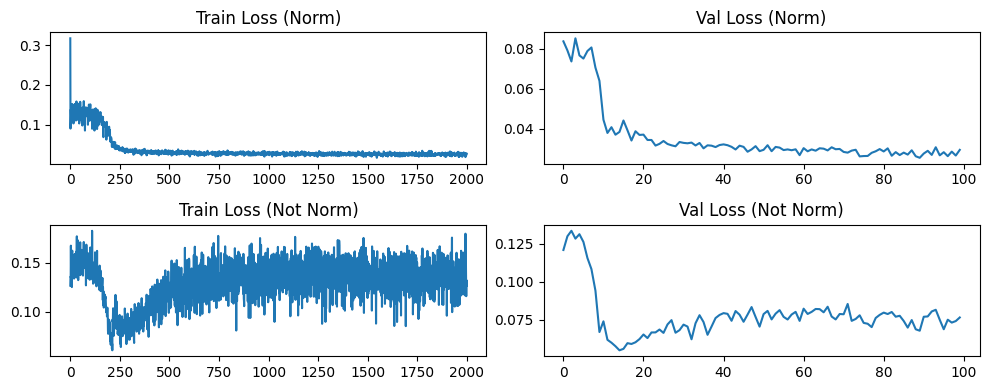

In [9]:
# definizione datasets e dataloaders
# vengono istanziati ogni volta che la run ha inizio così da gestire meglio ed impedire
# errori sul calcolo dei batch
train_dataset = CustomDataset(train_df, BATCH_SIZE)
train_dataloader = DataLoader(train_dataset, batch_size=BATCH_SIZE, collate_fn=collate_fn, shuffle=True)
val_dataset = CustomDataset(val_df, BATCH_SIZE)
val_dataloader = DataLoader(val_dataset, batch_size=BATCH_SIZE, collate_fn=collate_fn, shuffle=True)

t_loss_list, t_loss_notnorm_list, v_loss_list, v_loss_notnorm_list = [], [], [], []
loop = tqdm(range(run.config['epochs']), unit="epoch")
early_stopping = EarlyStopper(patience=20)
best_vloss = 1_000_000.
loss = nn.L1Loss()

run.config['early_stopping'] = str(early_stopping)
run.config['save_best'] = True
run.watch(model)

for epoch in loop:
    model.train()
    for batch_idx, (before, target, future, after, m_b, b_t, m_a, timestamps, _) in enumerate(train_dataloader):        
        target, before, after, future = target.to(device), before.to(device), after.to(device), future.to(device)
        
        train_pred = model(before, after, future)
        train_loss = loss((train_pred/train_pred.sum(dim=(1,2), keepdim=True)) * target.sum(dim=(1,2), keepdim=True), target)
        
        optimizer.zero_grad()
        train_loss.backward()
        optimizer.step()
        
        t_loss_list.append(train_loss.item())

        with torch.no_grad(): # TODO: ricontrollare
            t_loss_notnorm_list.append(loss(train_pred, target).item())

    model.eval()
    running_vloss = 0.0
    running_vloss_notnorm = 0.0

    # Disable gradient computation and reduce memory consumption.
    with torch.no_grad():
        for i, (vbefore, vtarget, vfuture, vafter, vm_b, vm_t, vm_a, vtimestamp, _) in enumerate(val_dataloader):
            vbefore, vtarget, vfuture, vafter = vbefore.to(device), vtarget.to(device), vfuture.to(device), vafter.to(device)
            voutputs = model(vbefore, vafter, vfuture)
            #vloss = loss(voutputs, vtarget)
            # voutputs = (voutputs * vfuture[:,:,-1].reshape(voutputs.shape)) # output * isday
            vloss = loss((voutputs/voutputs.sum(dim=(1,2), keepdim=True)) * vtarget.sum(dim=(1,2), keepdim=True), vtarget)
            vloss_notnorm = loss(voutputs, vtarget)

            running_vloss += vloss
            running_vloss_notnorm += vloss_notnorm

    # resetting dataset generation
    # TODO: fix con DROP LAST
    train_dataset.reset()
    val_dataset.reset()
    
    avg_vloss = running_vloss / (i + 1) # TODO: ricontrollare
    avg_vloss_notnorm = running_vloss_notnorm / (i + 1) # TODO: ricontrollare

    v_loss_list.append(avg_vloss.item())
    v_loss_notnorm_list.append(avg_vloss_notnorm.item())
    
    loop.set_description(f"Epoch [{epoch}/{run.config['epochs']}]")
    loop.set_postfix(loss=t_loss_list[-1], val_loss=v_loss_list[-1])
    
    run.log({"loss": t_loss_list[-1], "val_loss": v_loss_list[-1]})
    
    print(
            f"Epoch {epoch+1:02d}/{run.config['epochs']:02d}"
            f" | Train Loss {t_loss_list[-1]:.3f}"
            f" | Val Loss {v_loss_list[-1]:.3f}"
        )
    
    # save model when improves loss
    if avg_vloss < best_vloss:
        print(f"\tSaving model (improve loss) {best_vloss} -> {avg_vloss}")
        best_vloss = avg_vloss
        model_path = f"./models/GRRUN15MIN_b{run.config['batch_size']}_e{run.config['epochs']}.model"
        torch.save(model.state_dict(), model_path)

    # check for early stopping
    if early_stopping.early_stop(v_loss_list[-1]):
        print(f"\tEarly Stopping @ epoch {epoch} loss: {t_loss_list[-1]} val_loss: {v_loss_list[-1]}")
        break

# plot training/validation loss
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(10, 4))
axes[0, 0].set_title("Train Loss (Norm)")
axes[0, 0].plot(t_loss_list)
axes[0, 1].set_title("Val Loss (Norm)")
axes[0, 1].plot(v_loss_list)
axes[1, 0].set_title("Train Loss (Not Norm)")
axes[1, 0].plot(t_loss_notnorm_list)
axes[1, 1].set_title("Val Loss (Not Norm)")
axes[1, 1].plot(v_loss_notnorm_list)
fig.tight_layout()

### Evaluation

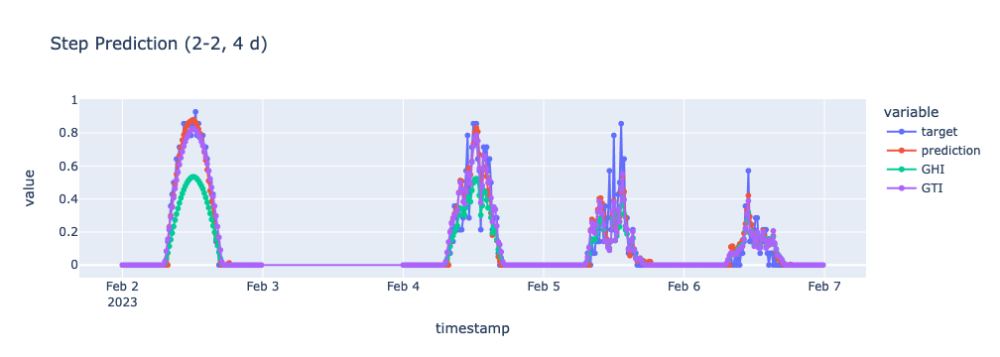

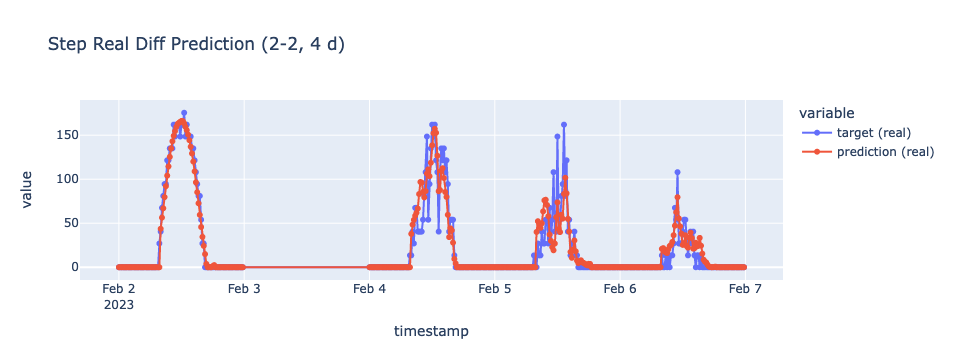

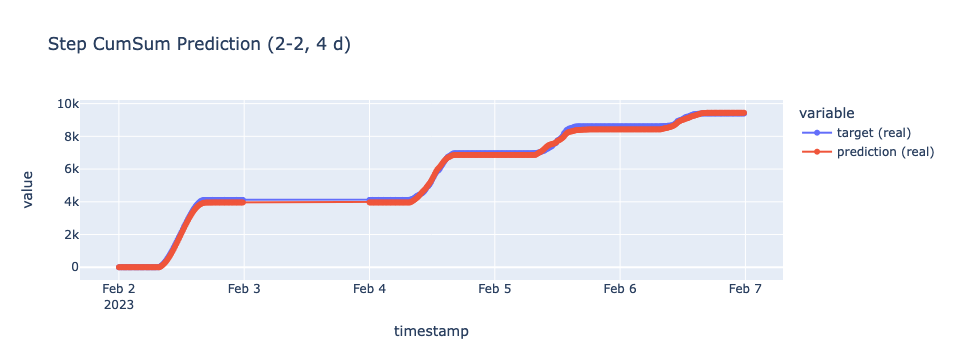

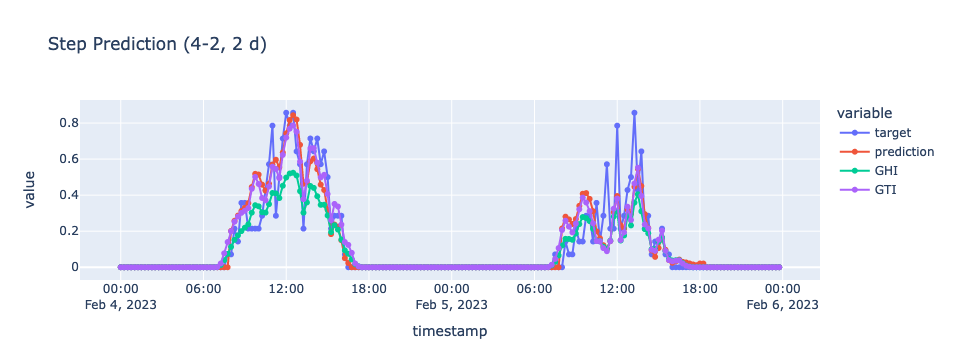

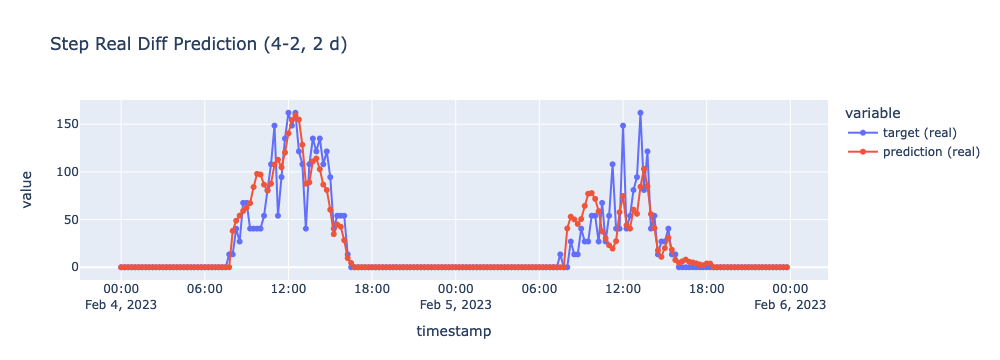

...

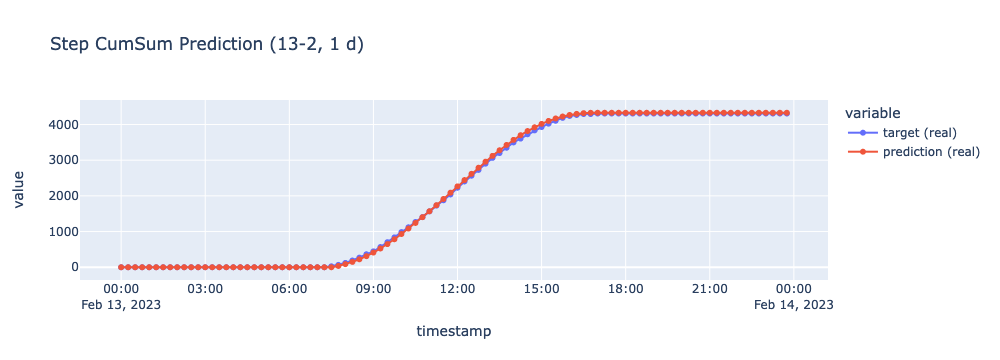

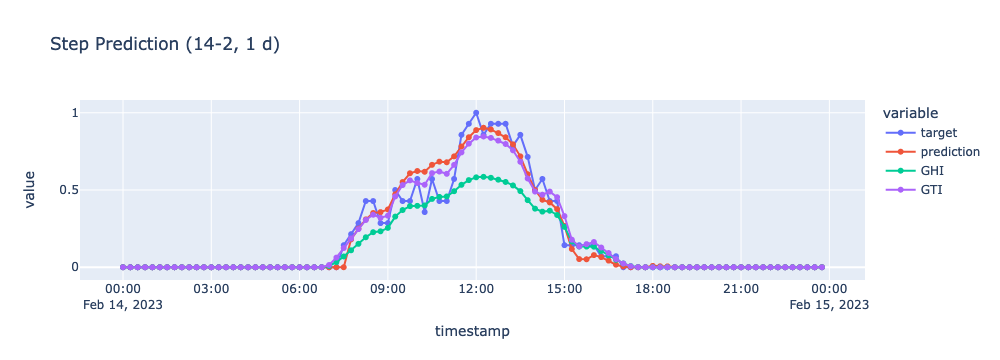

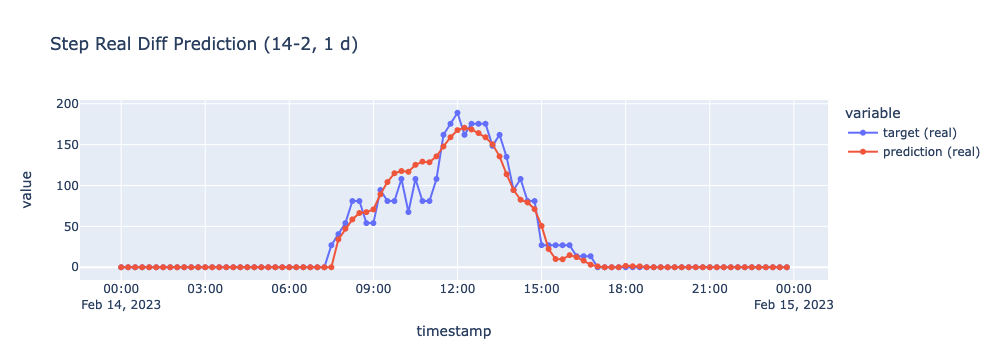

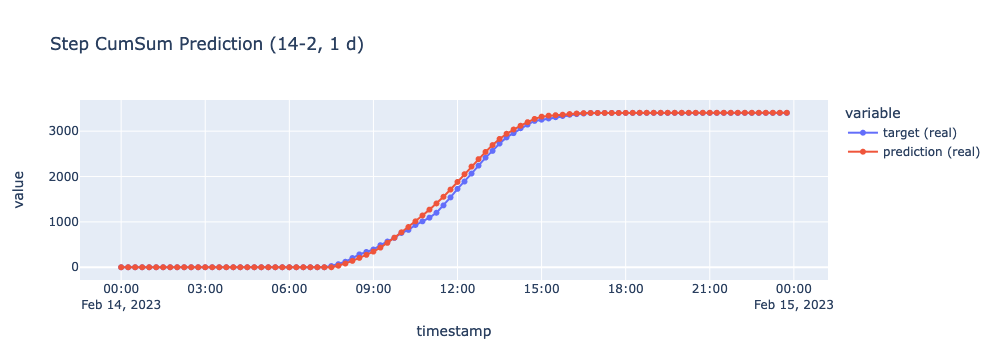

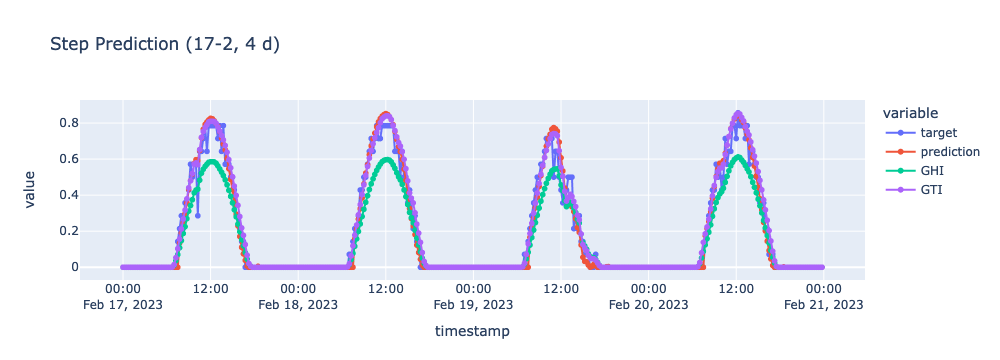

In [10]:
%run ./Modules/Evaluation.ipynb
model.load_state_dict(torch.load('./models/GRRUN15MIN_b10_e100.model'))
evaluate(model)

## Test Dataset 1

In [5]:
train_df, val_df, test_df1, test_df2, train_scaler, train_target_scaler = datasets['test 1'].copy()

In [6]:
run = wandb.init(
    project="interpolation",
    name="Giga Recurrent Random Unbounded Network (15 Min) ➿",
    config={
        "learning_rate": 0.001,
        "architecture": "GRRUNH",
        "dataset": "RofiloAnnuale-FullCyclingEncoding",
        "epochs": 100,
        "batch_size": BATCH_SIZE, #10
        "window_size": 1,
        "target_size": 1,
        "seed": SEED,
    },
    notes="Train con Dataset 1. No BUCHI TotalEnergy",
)

wandb: Currently logged in as: nicolo-vescera (rofilopd). Use `wandb login --relogin` to force relogin


In [8]:
model = NeuralNetwork().to(device)
# optimizer = torch.optim.SGD(model.parameters(), lr=run.config['learning_rate'])
optimizer = torch.optim.Adam(model.parameters(), lr=run.config['learning_rate'])

print(model)
print(optimizer)

run.config['optimizer'] = optimizer

NeuralNetwork(
  (input_before): GRU(48, 32, batch_first=True)
  (input_after): GRU(48, 32, batch_first=True)
  (flat): Flatten(start_dim=1, end_dim=-1)
  (linear1_2): Linear(in_features=64, out_features=128, bias=True)
  (linear2_2): Linear(in_features=128, out_features=128, bias=True)
  (loopGru): GRU(18, 128, batch_first=True)
  (output_layer): Linear(in_features=128, out_features=1, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.001
    weight_decay: 0
)


In [9]:
model_graph = draw_graph(model, input_size=[(5, 287, 48), (5, 287, 48), (5, 287, 18)], save_graph=True, expand_nested=True, device=device)
model_graph.visual_graph
run.log({"Model Shape": wandb.Image("model.gv.png")})

### Training

  0%|          | 0/100 [00:00<?, ?epoch/s]

Epoch 01/100 | Train Loss 0.089 | Val Loss 0.063
	Saving model (improve loss) 1000000.0 -> 0.0633431226015091
Epoch 02/100 | Train Loss 0.079 | Val Loss 0.266
Epoch 03/100 | Train Loss 0.090 | Val Loss 0.066
Epoch 04/100 | Train Loss 0.079 | Val Loss 0.056
	Saving model (improve loss) 0.0633431226015091 -> 0.056104451417922974
Epoch 05/100 | Train Loss 0.080 | Val Loss 0.070
Epoch 06/100 | Train Loss 0.096 | Val Loss 0.061
Epoch 07/100 | Train Loss 0.069 | Val Loss 0.066
Epoch 08/100 | Train Loss 0.080 | Val Loss 0.057
Epoch 09/100 | Train Loss 0.064 | Val Loss 0.050
	Saving model (improve loss) 0.056104451417922974 -> 0.050373177975416183
Epoch 10/100 | Train Loss 0.062 | Val Loss 0.047
	Saving model (improve loss) 0.050373177975416183 -> 0.04742453247308731
Epoch 11/100 | Train Loss 0.053 | Val Loss 0.044
	Saving model (improve loss) 0.04742453247308731 -> 0.04384986683726311
Epoch 12/100 | Train Loss 0.046 | Val Loss 0.115
Epoch 13/100 | Train Loss 0.117 | Val Loss 0.085
Epoch 14/10

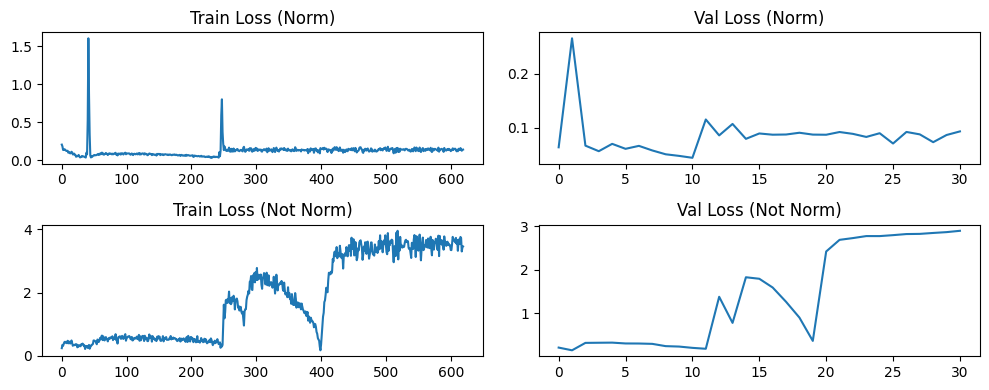

In [15]:
# definizione datasets e dataloaders
# vengono istanziati ogni volta che la run ha inizio così da gestire meglio ed impedire
# errori sul calcolo dei batch
train_dataset = CustomDataset(train_df, BATCH_SIZE)
train_dataloader = DataLoader(train_dataset, batch_size=BATCH_SIZE, collate_fn=collate_fn, shuffle=True)
val_dataset = CustomDataset(val_df, BATCH_SIZE)
val_dataloader = DataLoader(val_dataset, batch_size=BATCH_SIZE, collate_fn=collate_fn, shuffle=True)

t_loss_list, t_loss_notnorm_list, v_loss_list, v_loss_notnorm_list = [], [], [], []
loop = tqdm(range(run.config['epochs']), unit="epoch")
early_stopping = EarlyStopper(patience=20)
best_vloss = 1_000_000.
loss = nn.L1Loss()

run.config['early_stopping'] = str(early_stopping)
run.config['save_best'] = True
run.watch(model)

for epoch in loop:
    model.train()
    for batch_idx, (before, target, future, after, m_b, b_t, m_a, timestamps, _) in enumerate(train_dataloader):        
        target, before, after, future = target.to(device), before.to(device), after.to(device), future.to(device)
        
        train_pred = model(before, after, future)
        train_loss = loss((train_pred/train_pred.sum(dim=(1,2), keepdim=True)) * target.sum(dim=(1,2), keepdim=True), target)
        
        optimizer.zero_grad()
        train_loss.backward()
        optimizer.step()
        
        t_loss_list.append(train_loss.item())

        with torch.no_grad(): # TODO: ricontrollare
            t_loss_notnorm_list.append(loss(train_pred, target).item())

    model.eval()
    running_vloss = 0.0
    running_vloss_notnorm = 0.0

    # Disable gradient computation and reduce memory consumption.
    with torch.no_grad():
        for i, (vbefore, vtarget, vfuture, vafter, vm_b, vm_t, vm_a, vtimestamp, _) in enumerate(val_dataloader):
            vbefore, vtarget, vfuture, vafter = vbefore.to(device), vtarget.to(device), vfuture.to(device), vafter.to(device)
            voutputs = model(vbefore, vafter, vfuture)
            #vloss = loss(voutputs, vtarget)
            # voutputs = (voutputs * vfuture[:,:,-1].reshape(voutputs.shape)) # output * isday
            vloss = loss((voutputs/voutputs.sum(dim=(1,2), keepdim=True)) * vtarget.sum(dim=(1,2), keepdim=True), vtarget)
            vloss_notnorm = loss(voutputs, vtarget)

            running_vloss += vloss
            running_vloss_notnorm += vloss_notnorm

    # resetting dataset generation
    # TODO: fix con DROP LAST
    train_dataset.reset()
    val_dataset.reset()
    
    avg_vloss = running_vloss / (i + 1) # TODO: ricontrollare
    avg_vloss_notnorm = running_vloss_notnorm / (i + 1) # TODO: ricontrollare

    v_loss_list.append(avg_vloss.item())
    v_loss_notnorm_list.append(avg_vloss_notnorm.item())
    
    loop.set_description(f"Epoch [{epoch}/{run.config['epochs']}]")
    loop.set_postfix(loss=t_loss_list[-1], val_loss=v_loss_list[-1])
    
    run.log({"loss": t_loss_list[-1], "val_loss": v_loss_list[-1]})
    
    print(
            f"Epoch {epoch+1:02d}/{run.config['epochs']:02d}"
            f" | Train Loss {t_loss_list[-1]:.3f}"
            f" | Val Loss {v_loss_list[-1]:.3f}"
        )
    
    # save model when improves loss
    if avg_vloss < best_vloss:
        print(f"\tSaving model (improve loss) {best_vloss} -> {avg_vloss}")
        best_vloss = avg_vloss
        model_path = f"./models/GRRUN15MIN_T1_b{run.config['batch_size']}_e{run.config['epochs']}.model"
        torch.save(model.state_dict(), model_path)

    # check for early stopping
    if early_stopping.early_stop(v_loss_list[-1]):
        print(f"\tEarly Stopping @ epoch {epoch} loss: {t_loss_list[-1]} val_loss: {v_loss_list[-1]}")
        break

# plot training/validation loss
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(10, 4))
axes[0, 0].set_title("Train Loss (Norm)")
axes[0, 0].plot(t_loss_list)
axes[0, 1].set_title("Val Loss (Norm)")
axes[0, 1].plot(v_loss_list)
axes[1, 0].set_title("Train Loss (Not Norm)")
axes[1, 0].plot(t_loss_notnorm_list)
axes[1, 1].set_title("Val Loss (Not Norm)")
axes[1, 1].plot(v_loss_notnorm_list)
fig.tight_layout()

### Evaluation

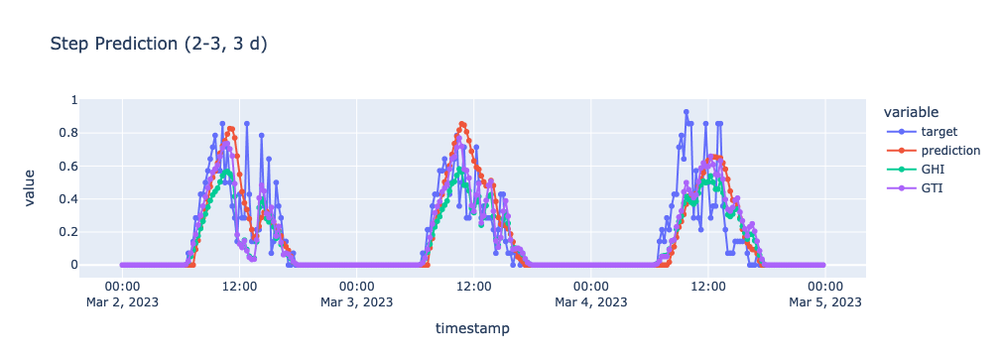

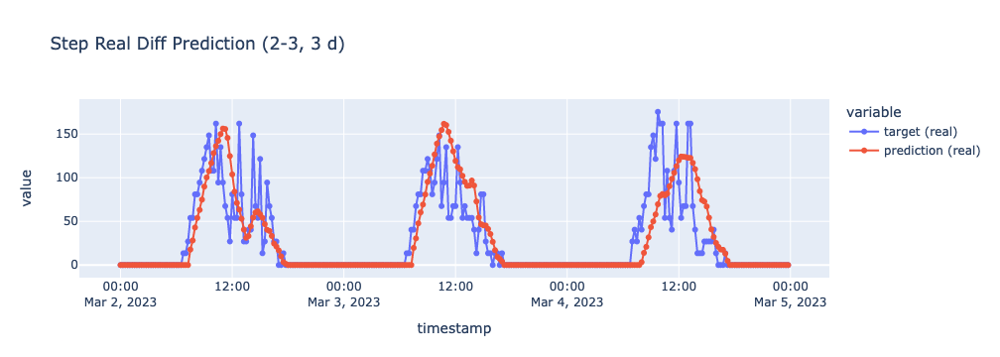

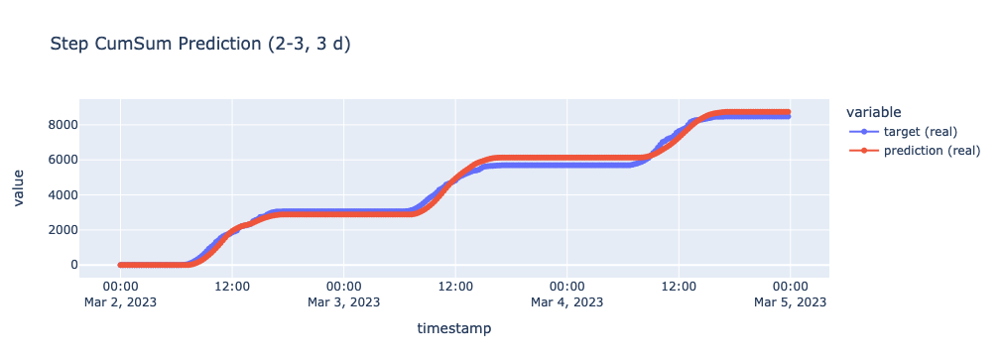

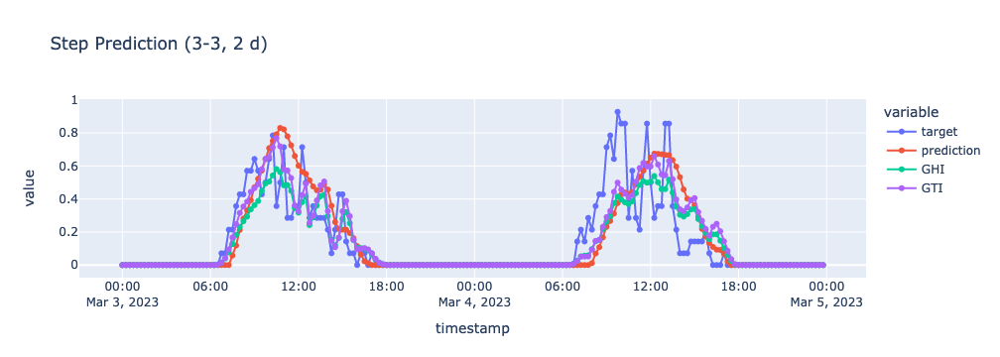

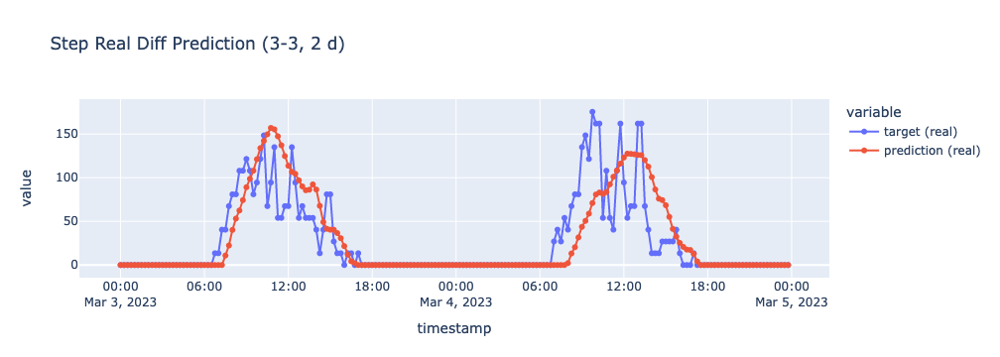

...

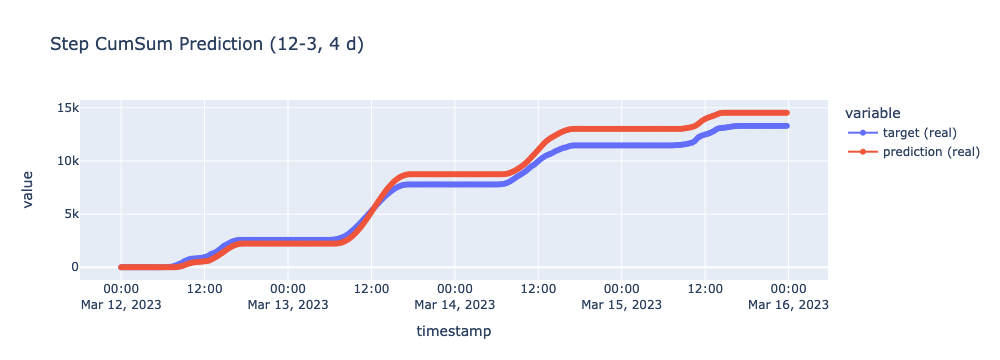

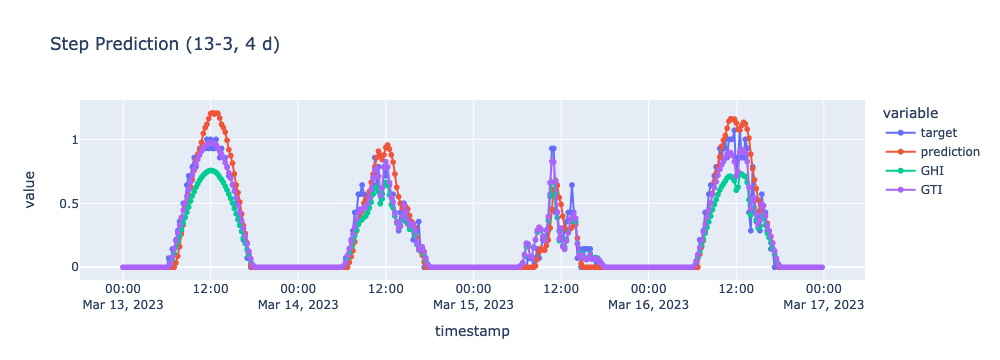

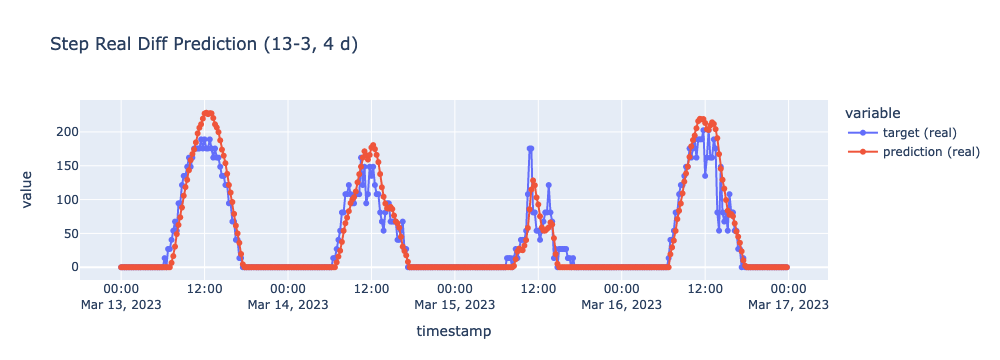

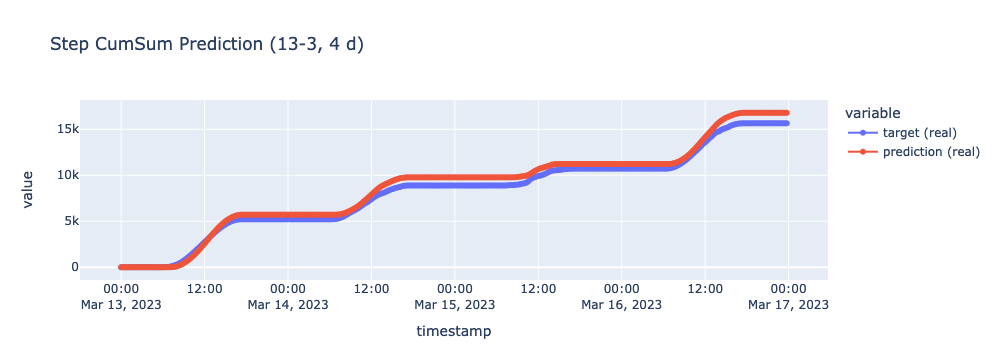

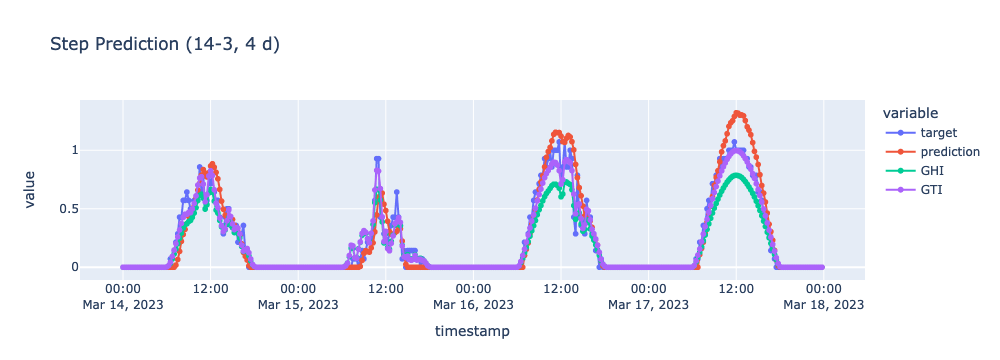

In [10]:
%run ./Modules/Evaluation.ipynb
model.load_state_dict(torch.load('./models/GRRUN15MIN_T1_b10_e100.model'))
test_df = test_df1.copy()
evaluate(model, finish_run=False)

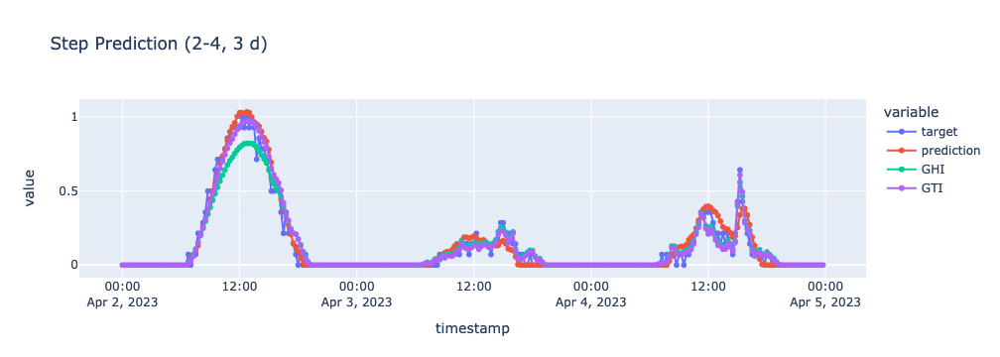

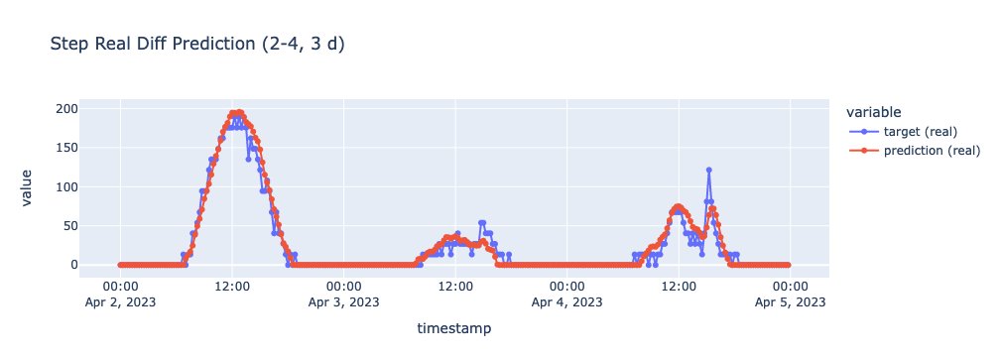

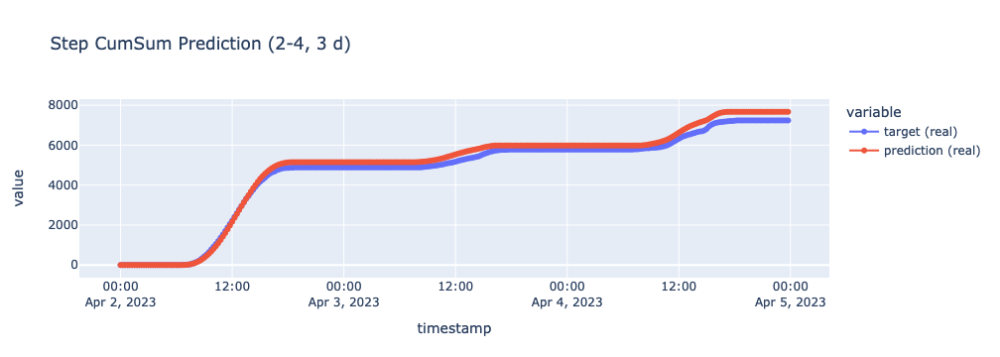

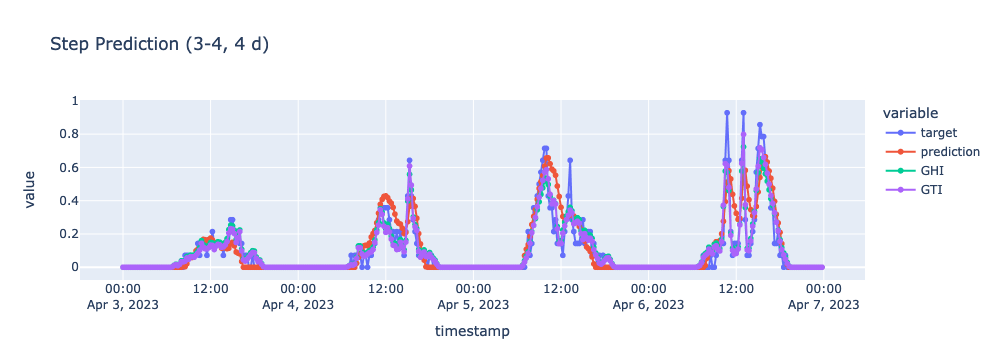

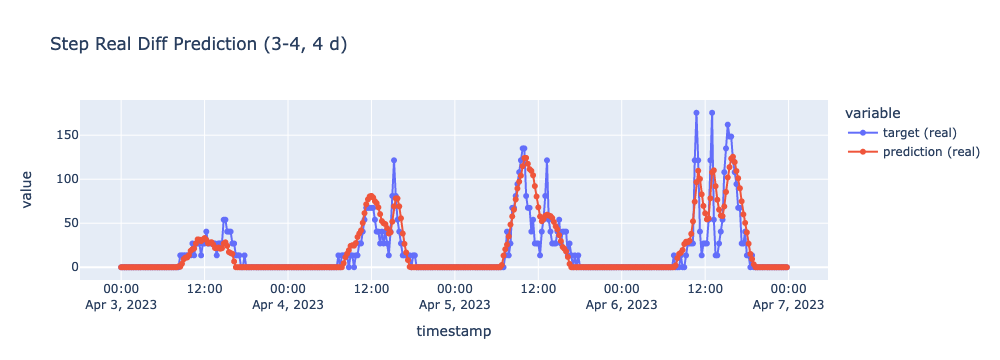

...

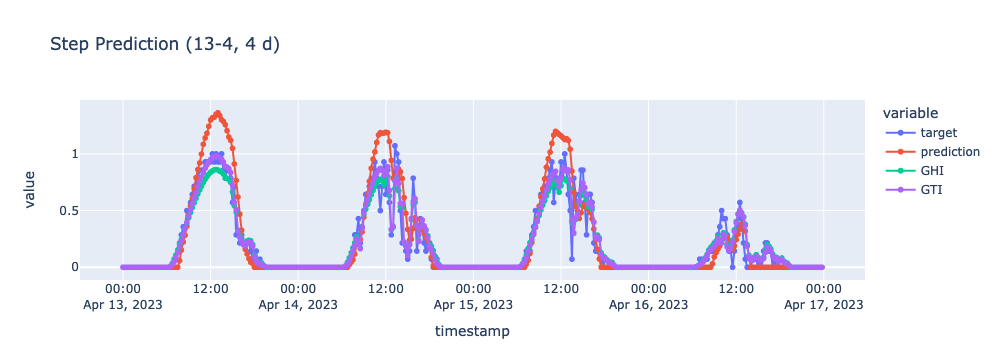

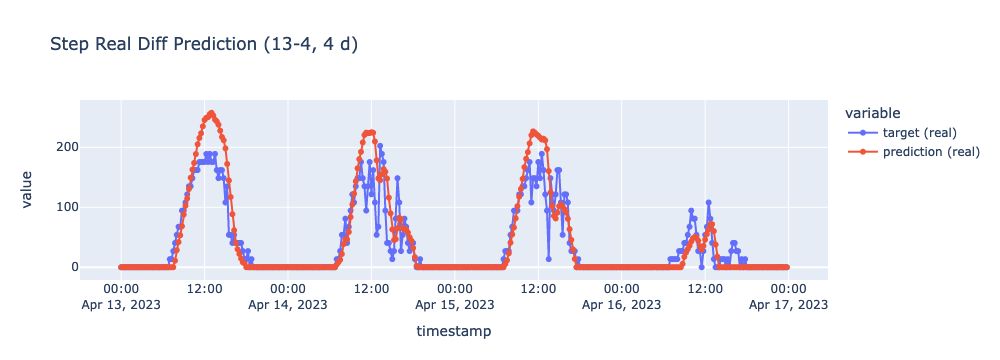

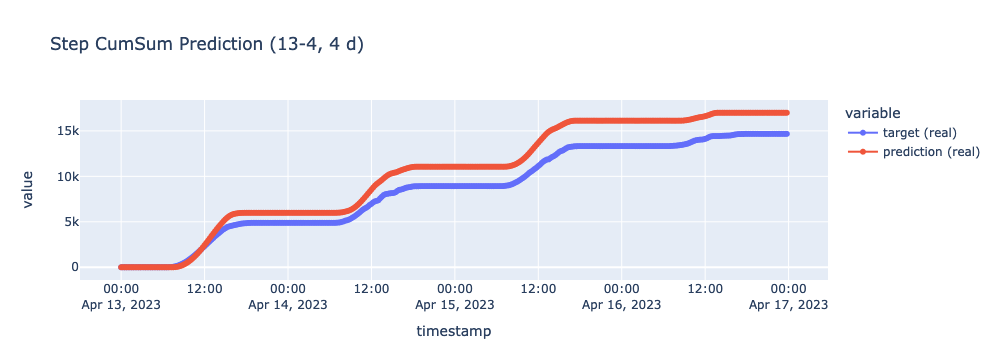

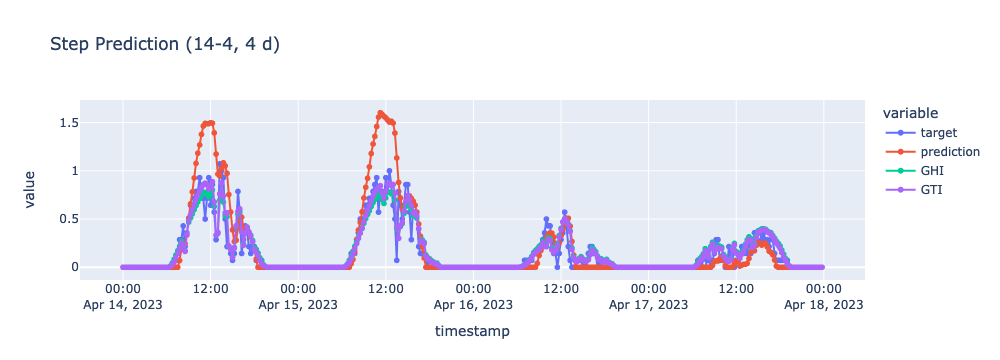

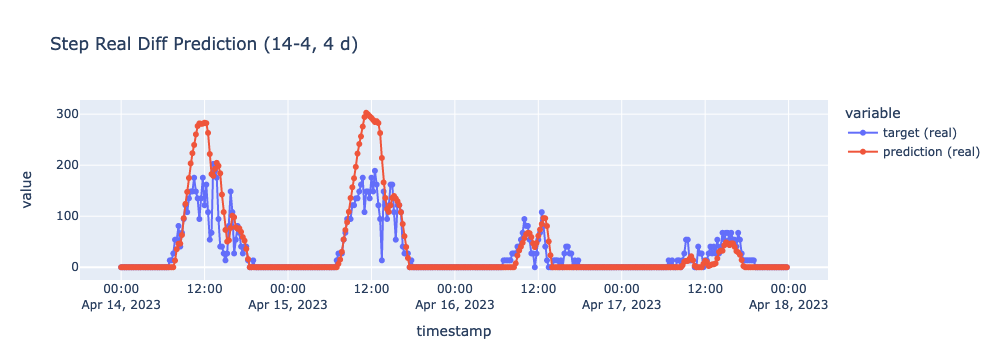

wandb: WARNING Failed to cache /home/jovyan/.local/share/wandb/artifacts/staging/tmpfyw94oit, ignoring [Errno 28] No space left on device: '/home/jovyan/.local/share/wandb/artifacts/staging/tmpfyw94oit' -> '/home/jovyan/.cache/wandb/artifacts/obj/md5/33/tmp_81b464b111fd757a'
wandb: WARNING Failed to cache /home/jovyan/.local/share/wandb/artifacts/staging/tmp1tvf9xng, ignoring [Errno 28] No space left on device: '/home/jovyan/.local/share/wandb/artifacts/staging/tmp1tvf9xng' -> '/home/jovyan/.cache/wandb/artifacts/obj/md5/ce/tmp_bb9ac3ed5677bc67'
wandb: WARNING Failed to cache /home/jovyan/.local/share/wandb/artifacts/staging/tmp6haq6pnt, ignoring [Errno 28] No space left on device: '/home/jovyan/.local/share/wandb/artifacts/staging/tmp6haq6pnt' -> '/home/jovyan/.cache/wandb/artifacts/obj/md5/d0/tmp_c0c244de5f2141e2'
wandb: WARNING Failed to cache /home/jovyan/.local/share/wandb/artifacts/staging/tmpgli6ozql, ignoring [Errno 28] No space left on device: '/home/jovyan/.local/share/wandb/

In [11]:
test_df = test_df2.copy()
evaluate(model)

## Test Dataset 2

In [5]:
train_df, val_df, test_df, train_scaler, train_target_scaler = datasets['test 2'].copy()

In [6]:
run = wandb.init(
    project="interpolation",
    name="Giga Recurrent Random Unbounded Network (15 Min) ➿",
    config={
        "learning_rate": 0.001,
        "architecture": "GRRUNH",
        "dataset": "RofiloAnnuale-FullCyclingEncoding",
        "epochs": 100,
        "batch_size": BATCH_SIZE, #10
        "window_size": 1,
        "target_size": 1,
        "seed": SEED,
    },
    notes="Train con Dataset 2. No BUCHI TotalEnergy",
)

wandb: Currently logged in as: nicolo-vescera (rofilopd). Use `wandb login --relogin` to force relogin


In [8]:
model = NeuralNetwork().to(device)
# optimizer = torch.optim.SGD(model.parameters(), lr=run.config['learning_rate'])
optimizer = torch.optim.Adam(model.parameters(), lr=run.config['learning_rate'])

print(model)
print(optimizer)

run.config['optimizer'] = optimizer

NeuralNetwork(
  (input_before): GRU(48, 32, batch_first=True)
  (input_after): GRU(48, 32, batch_first=True)
  (flat): Flatten(start_dim=1, end_dim=-1)
  (linear1_2): Linear(in_features=64, out_features=128, bias=True)
  (linear2_2): Linear(in_features=128, out_features=128, bias=True)
  (loopGru): GRU(18, 128, batch_first=True)
  (output_layer): Linear(in_features=128, out_features=1, bias=True)
)
Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.001
    weight_decay: 0
)


In [9]:
model_graph = draw_graph(model, input_size=[(5, 287, 48), (5, 287, 48), (5, 287, 18)], save_graph=True, expand_nested=True, device=device)
model_graph.visual_graph
run.log({"Model Shape": wandb.Image("model.gv.png")})

### Training

  0%|          | 0/100 [00:00<?, ?epoch/s]

Epoch 01/100 | Train Loss 0.171 | Val Loss 0.125
	Saving model (improve loss) 1000000.0 -> 0.12501829862594604
Epoch 02/100 | Train Loss 0.130 | Val Loss 0.129
Epoch 03/100 | Train Loss 0.129 | Val Loss 0.123
	Saving model (improve loss) 0.12501829862594604 -> 0.12317519634962082
Epoch 04/100 | Train Loss 0.121 | Val Loss 0.110
	Saving model (improve loss) 0.12317519634962082 -> 0.110483318567276
Epoch 05/100 | Train Loss 0.097 | Val Loss 0.089
	Saving model (improve loss) 0.110483318567276 -> 0.08886246383190155
Epoch 06/100 | Train Loss 0.132 | Val Loss 0.140
Epoch 07/100 | Train Loss 0.107 | Val Loss 0.145
Epoch 08/100 | Train Loss 0.126 | Val Loss 0.138
Epoch 09/100 | Train Loss 0.130 | Val Loss 0.138
Epoch 10/100 | Train Loss 0.149 | Val Loss 0.138
Epoch 11/100 | Train Loss 0.137 | Val Loss 0.145
Epoch 12/100 | Train Loss 0.134 | Val Loss 0.139
Epoch 13/100 | Train Loss 0.068 | Val Loss 0.134
Epoch 14/100 | Train Loss 0.107 | Val Loss 0.141
Epoch 15/100 | Train Loss 0.105 | Val Lo

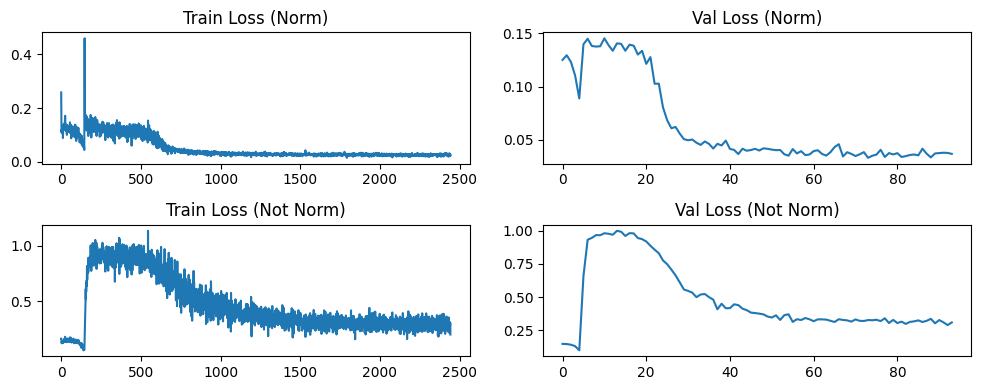

In [22]:
# definizione datasets e dataloaders
# vengono istanziati ogni volta che la run ha inizio così da gestire meglio ed impedire
# errori sul calcolo dei batch
train_dataset = CustomDataset(train_df, BATCH_SIZE)
train_dataloader = DataLoader(train_dataset, batch_size=BATCH_SIZE, collate_fn=collate_fn, shuffle=True)
val_dataset = CustomDataset(val_df, BATCH_SIZE)
val_dataloader = DataLoader(val_dataset, batch_size=BATCH_SIZE, collate_fn=collate_fn, shuffle=True)

t_loss_list, t_loss_notnorm_list, v_loss_list, v_loss_notnorm_list = [], [], [], []
loop = tqdm(range(run.config['epochs']), unit="epoch")
early_stopping = EarlyStopper(patience=20)
best_vloss = 1_000_000.
loss = nn.L1Loss()

run.config['early_stopping'] = str(early_stopping)
run.config['save_best'] = True
run.watch(model)

for epoch in loop:
    model.train()
    for batch_idx, (before, target, future, after, m_b, b_t, m_a, timestamps, _) in enumerate(train_dataloader):        
        target, before, after, future = target.to(device), before.to(device), after.to(device), future.to(device)
        
        train_pred = model(before, after, future)
        train_loss = loss((train_pred/train_pred.sum(dim=(1,2), keepdim=True)) * target.sum(dim=(1,2), keepdim=True), target)
        
        optimizer.zero_grad()
        train_loss.backward()
        optimizer.step()
        
        t_loss_list.append(train_loss.item())

        with torch.no_grad(): # TODO: ricontrollare
            t_loss_notnorm_list.append(loss(train_pred, target).item())

    model.eval()
    running_vloss = 0.0
    running_vloss_notnorm = 0.0

    # Disable gradient computation and reduce memory consumption.
    with torch.no_grad():
        for i, (vbefore, vtarget, vfuture, vafter, vm_b, vm_t, vm_a, vtimestamp, _) in enumerate(val_dataloader):
            vbefore, vtarget, vfuture, vafter = vbefore.to(device), vtarget.to(device), vfuture.to(device), vafter.to(device)
            voutputs = model(vbefore, vafter, vfuture)
            #vloss = loss(voutputs, vtarget)
            # voutputs = (voutputs * vfuture[:,:,-1].reshape(voutputs.shape)) # output * isday
            vloss = loss((voutputs/voutputs.sum(dim=(1,2), keepdim=True)) * vtarget.sum(dim=(1,2), keepdim=True), vtarget)
            vloss_notnorm = loss(voutputs, vtarget)

            running_vloss += vloss
            running_vloss_notnorm += vloss_notnorm

    # resetting dataset generation
    # TODO: fix con DROP LAST
    train_dataset.reset()
    val_dataset.reset()
    
    avg_vloss = running_vloss / (i + 1) # TODO: ricontrollare
    avg_vloss_notnorm = running_vloss_notnorm / (i + 1) # TODO: ricontrollare

    v_loss_list.append(avg_vloss.item())
    v_loss_notnorm_list.append(avg_vloss_notnorm.item())
    
    loop.set_description(f"Epoch [{epoch}/{run.config['epochs']}]")
    loop.set_postfix(loss=t_loss_list[-1], val_loss=v_loss_list[-1])
    
    run.log({"loss": t_loss_list[-1], "val_loss": v_loss_list[-1]})
    
    print(
            f"Epoch {epoch+1:02d}/{run.config['epochs']:02d}"
            f" | Train Loss {t_loss_list[-1]:.3f}"
            f" | Val Loss {v_loss_list[-1]:.3f}"
        )
    
    # save model when improves loss
    if avg_vloss < best_vloss:
        print(f"\tSaving model (improve loss) {best_vloss} -> {avg_vloss}")
        best_vloss = avg_vloss
        model_path = f"./models/GRRUN15MIN_T2_b{run.config['batch_size']}_e{run.config['epochs']}.model"
        torch.save(model.state_dict(), model_path)

    # check for early stopping
    if early_stopping.early_stop(v_loss_list[-1]):
        print(f"\tEarly Stopping @ epoch {epoch} loss: {t_loss_list[-1]} val_loss: {v_loss_list[-1]}")
        break

# plot training/validation loss
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(10, 4))
axes[0, 0].set_title("Train Loss (Norm)")
axes[0, 0].plot(t_loss_list)
axes[0, 1].set_title("Val Loss (Norm)")
axes[0, 1].plot(v_loss_list)
axes[1, 0].set_title("Train Loss (Not Norm)")
axes[1, 0].plot(t_loss_notnorm_list)
axes[1, 1].set_title("Val Loss (Not Norm)")
axes[1, 1].plot(v_loss_notnorm_list)
fig.tight_layout()

### Evaluation

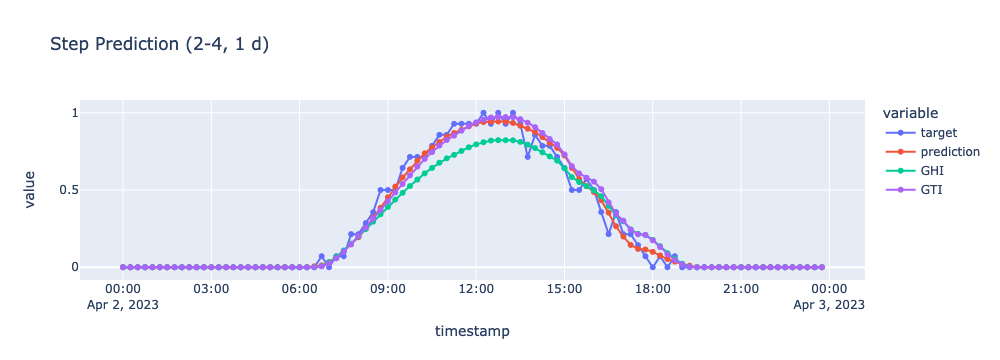

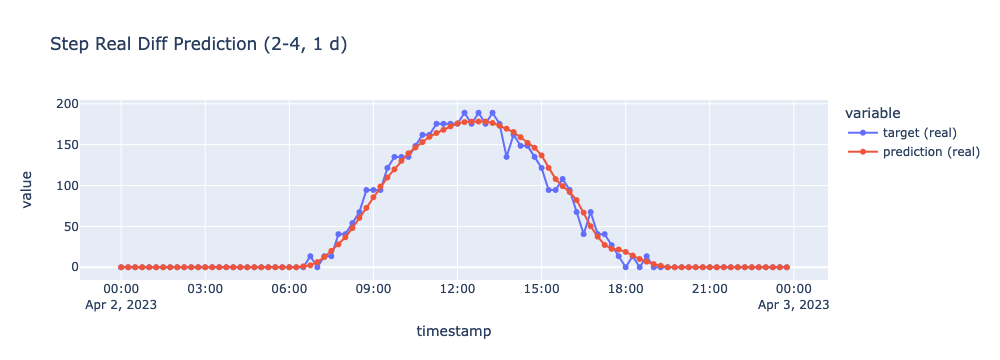

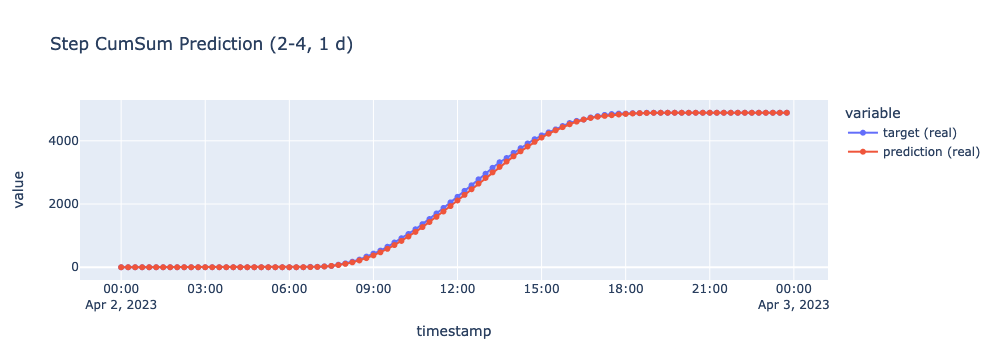

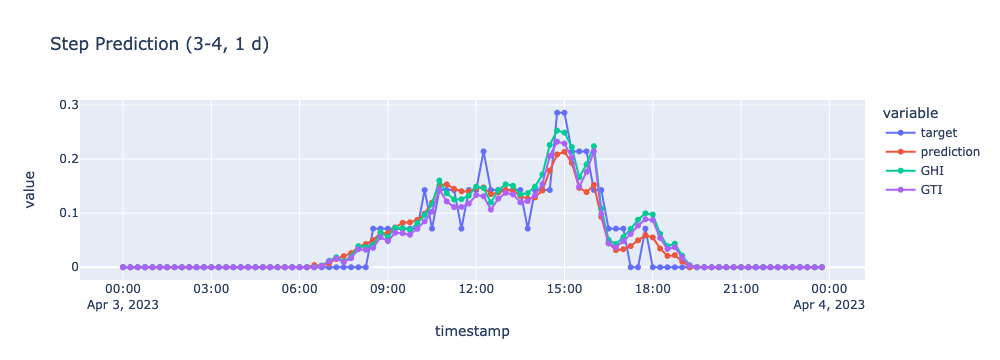

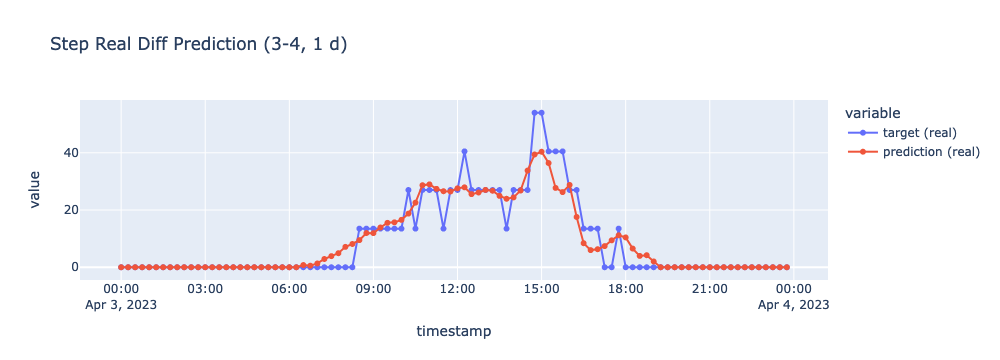

...

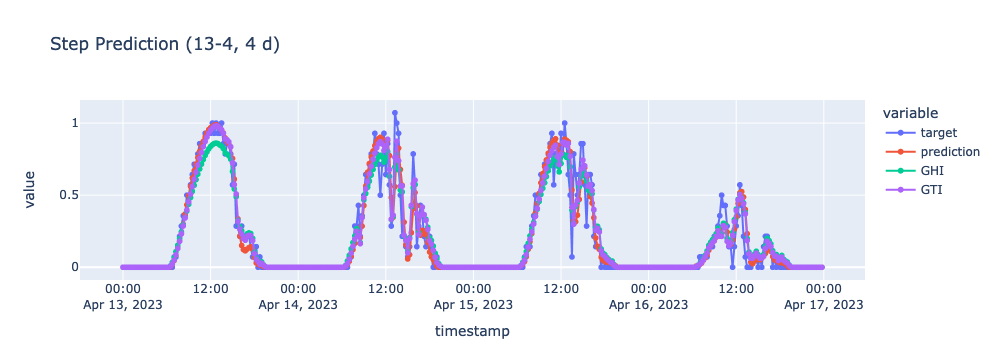

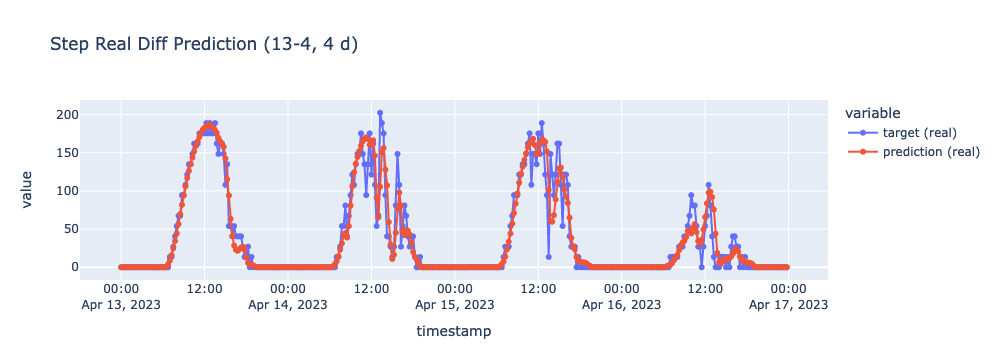

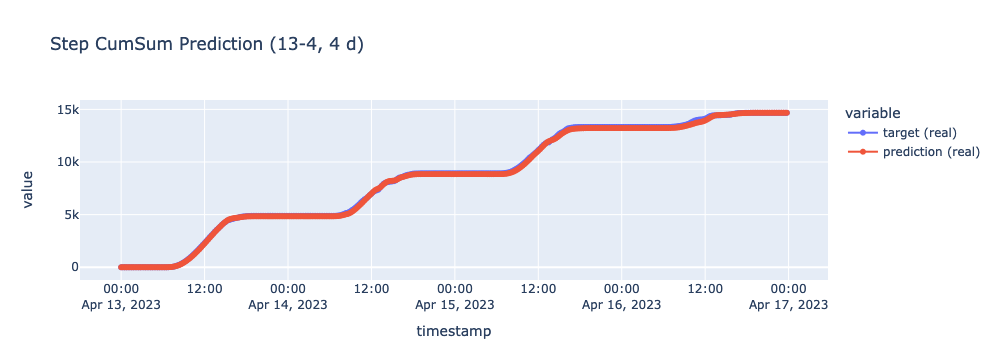

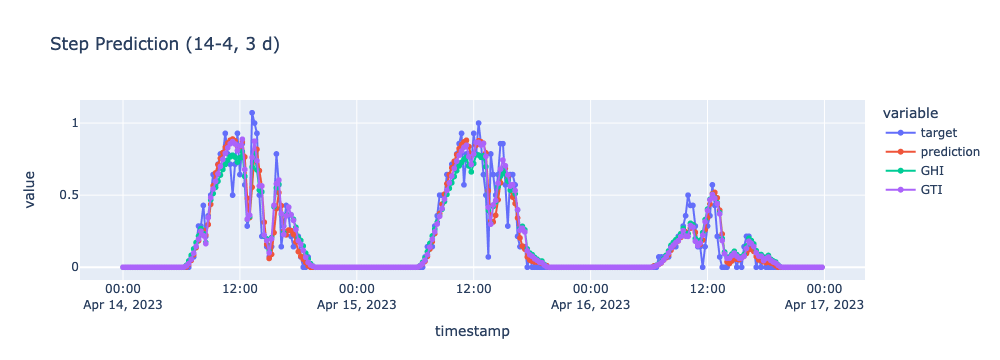

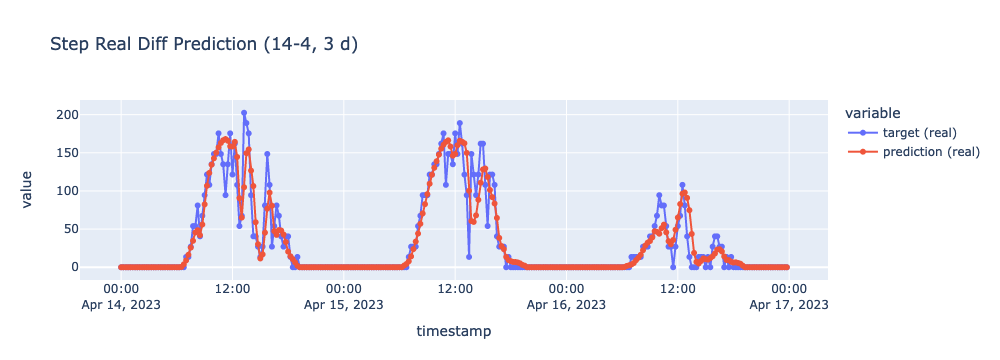

UsageError: Run (pie7q4q7) is finished. The call to `log` will be ignored. Please make sure that you are using an active run.

In [13]:
%run ./Modules/Evaluation.ipynb
model.load_state_dict(torch.load('./models/GRRUN15MIN_T2_b10_e100.model'))
evaluate(model)